# Homework 3
#### Matthew Jacobs

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt
import rebound

bright = [(68,119,170), (102,204,238), (34, 136, 51), (204,187,68), (238,102,119), (170,51,119), (187,187,187)]    
for i in range(len(bright)):    
    r, g, b = bright[i]    
    bright[i] = (r / 255., g / 255., b / 255.)     
highc = [(255,255,255), (221,170,51), (187, 85, 102), (0,68,136), (0,0,0)]    
for i in range(len(highc)):    
    r, g, b = highc[i]    
    highc[i] = (r / 255., g / 255., b / 255.)    
vibrant =  [(0,119,187), (51,187,238), (0, 153, 136), (238,119,51), (204,51,17), (238,51,119), (187,187,187)]   
for i in range(len(vibrant)):    
    r, g, b = vibrant[i]    
    vibrant[i] = (r / 255., g / 255., b / 255.)    
muted =  [(51,34,136), (136,204,238), (68, 170, 153), (17,119,51), (153,153,51), (221,204,119), (204,102,119), (136,34,85), (170, 68, 153), (221,221,221)]  
for i in range(len(muted)):    
    r, g, b = muted[i]    
    muted[i] = (r / 255., g / 255., b / 255.)    
light = [(119,170,221), (153, 221, 255), (68,187,153), (187,204,51), (170,170,0), (238,221,136), (238,136,102), (255,170,187),(221,221,221)]
for i in range(len(light)):    
    r, g, b = light[i]    
    light[i] = (r / 255., g / 255., b / 255.)   
basic =[(0,119,187),(17,119,51),(204,51,17),(85,85,85)]    
for i in range(len(basic)):    
    r, g, b = basic[i]    
    basic[i] = (r / 255., g / 255., b / 255.)
greys = [(255./4. * 3., 255./4.*3., 255./4.*3.), (255./4. * 2., 255./4.*2., 255./4.*2. ), (255./4., 255./4., 255./4. )]
for i in range(len(greys)):    
    r, g, b = greys[i]    
    greys[i] = (r / 255., g / 255., b / 255.)

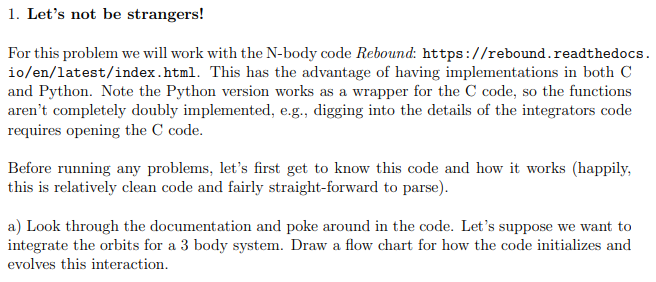

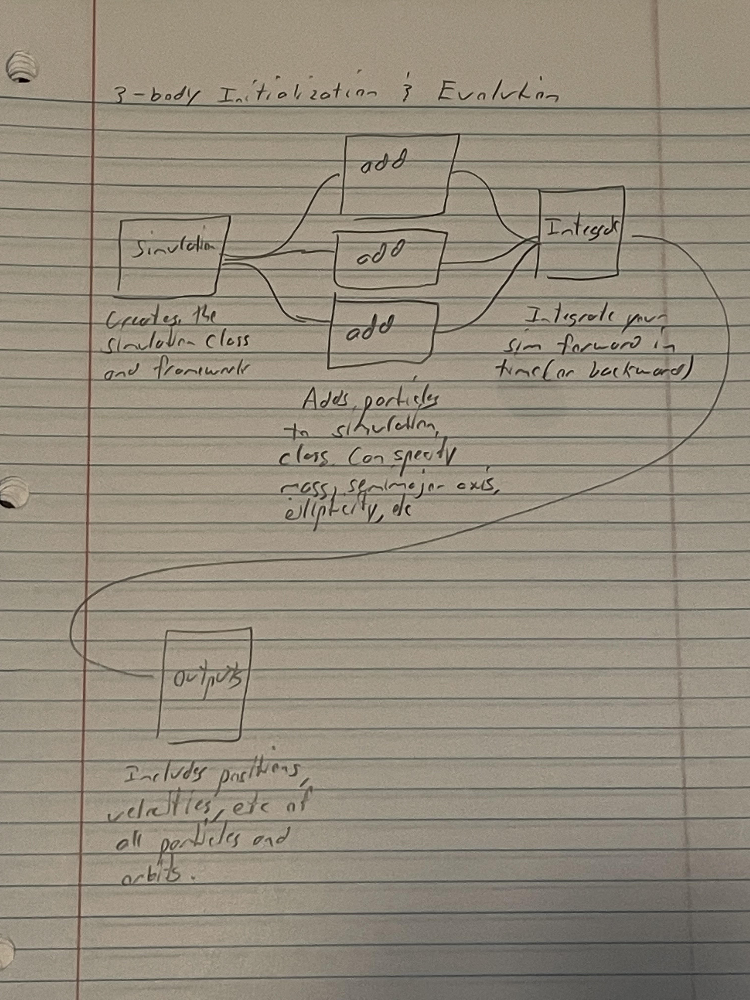

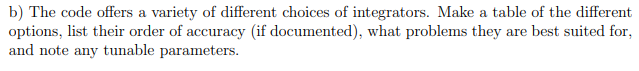

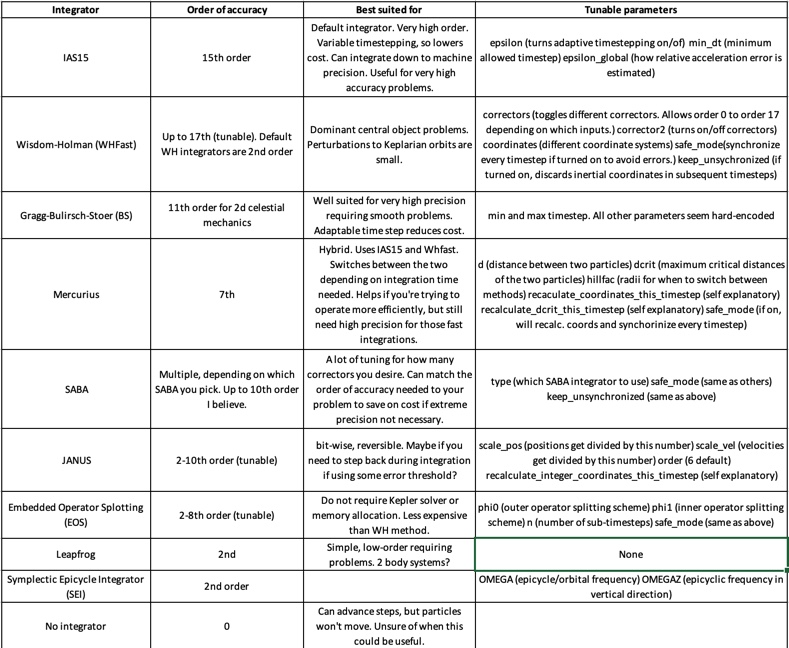

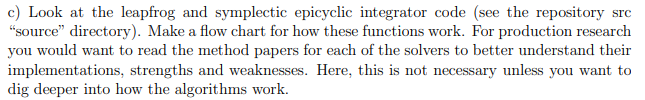

I'm not really able to read C, but did the best I could. Flowcharts are rather sloppy.
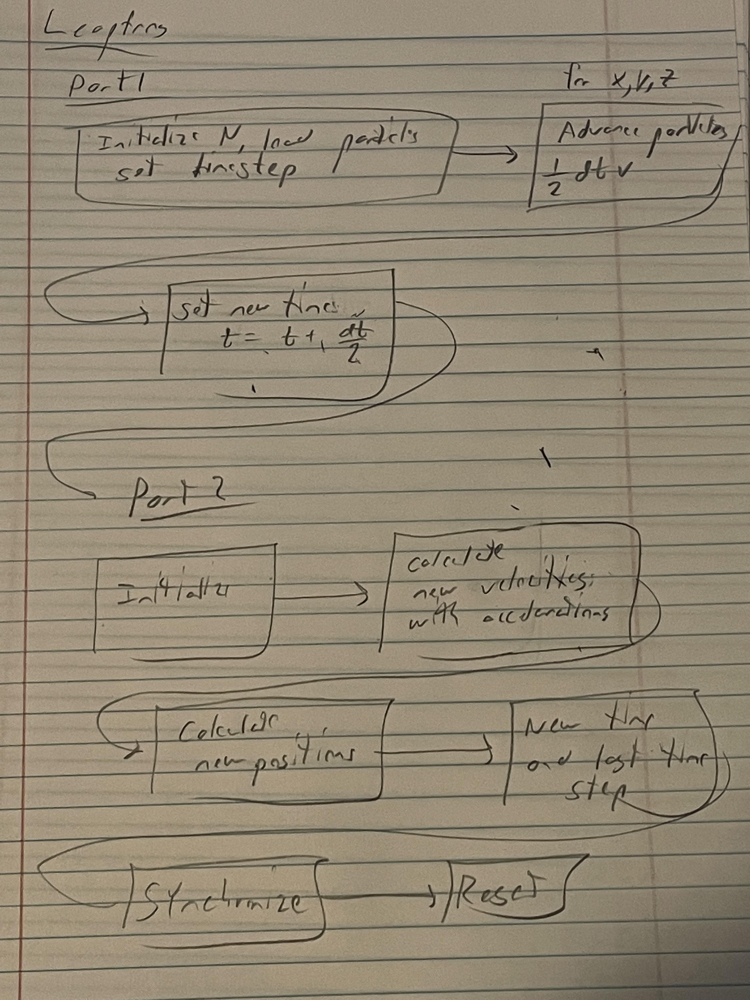
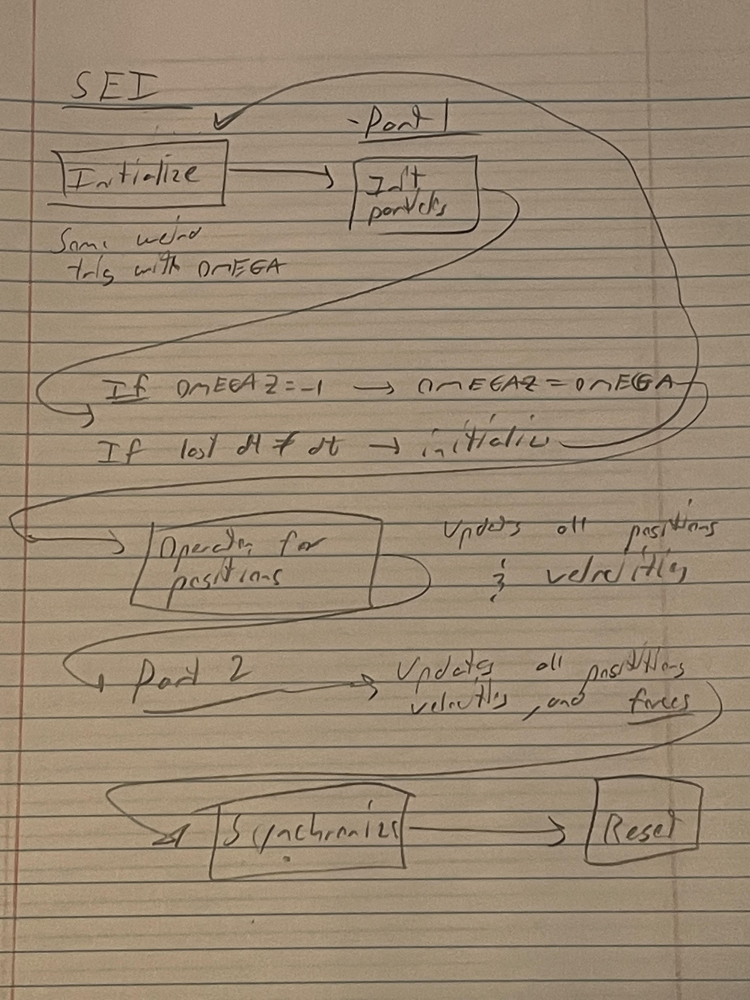


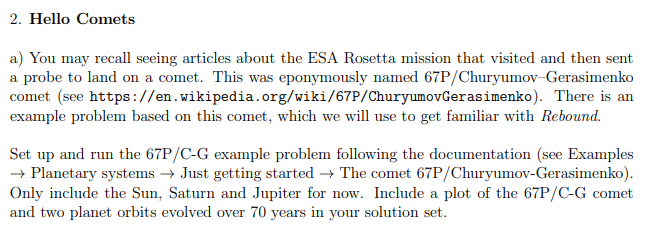

In [26]:
#create simulation and add in desired bodies.
sim = rebound.Simulation()
sim.add("Sun")
sim.add("Jupiter")
sim.add("Saturn")
sim.add("Churyumov-Gerasimenko", m=5.03e-18)

Searching NASA Horizons for 'Sun'... 
Found: Sun (10) 
Searching NASA Horizons for 'Jupiter'... 
Found: Jupiter Barycenter (5) (chosen from query 'Jupiter')
Searching NASA Horizons for 'Saturn'... 
Found: Saturn Barycenter (6) (chosen from query 'Saturn')
Searching NASA Horizons for 'Churyumov-Gerasimenko'... 
Found: 67P/Churyumov-Gerasimenko (chosen from query 'Churyumov-Gerasimenko')


In [28]:
year = 2*np.pi #one year in the G=1 default units
time = 70 * year #time to integrate by
sim.integrate(time)

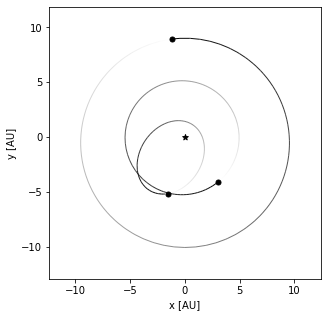

In [29]:
%matplotlib inline
fig = rebound.OrbitPlot(sim, unitlabel="[AU]")

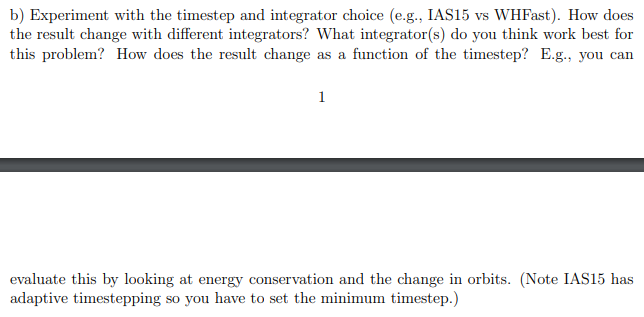

In [60]:
ias15_smallstep = rebound.Simulation()
ias15_smallstep.add("Sun")
ias15_smallstep.add("Jupiter")
ias15_smallstep.add("Saturn")
ias15_smallstep.add("Churyumov-Gerasimenko", m=5.03e-18)
ias15_smallenergy_init = ias15_smallstep.calculate_energy()
time = 70 * year #time to integrate by
ias15_smallstep.ri_ias15.min_dt = 1e-3*year #timestep for IAS15 integrator
ias15_smallstep.integrate(time)
ias15_smallenergy_final = ias15_smallstep.calculate_energy()
ias15_bigstep = rebound.Simulation()
ias15_bigstep.add("Sun")
ias15_bigstep.add("Jupiter")
ias15_bigstep.add("Saturn")
ias15_bigstep.add("Churyumov-Gerasimenko", m=5.03e-18)
ias15_bigenergy_init = ias15_bigstep.calculate_energy()
time = 70 * year #time to integrate by
ias15_bigstep.ri_ias15.min_dt = 1*year #timestep for IAS15 integrator
ias15_bigstep.integrate(time)
ias15_bigenergy_final = ias15_bigstep.calculate_energy()

Searching NASA Horizons for 'Sun'... 
Found: Sun (10) 
Searching NASA Horizons for 'Jupiter'... 
Found: Jupiter Barycenter (5) (chosen from query 'Jupiter')
Searching NASA Horizons for 'Saturn'... 
Found: Saturn Barycenter (6) (chosen from query 'Saturn')
Searching NASA Horizons for 'Churyumov-Gerasimenko'... 
Found: 67P/Churyumov-Gerasimenko (chosen from query 'Churyumov-Gerasimenko')
Searching NASA Horizons for 'Sun'... 
Found: Sun (10) 
Searching NASA Horizons for 'Jupiter'... 
Found: Jupiter Barycenter (5) (chosen from query 'Jupiter')
Searching NASA Horizons for 'Saturn'... 
Found: Saturn Barycenter (6) (chosen from query 'Saturn')
Searching NASA Horizons for 'Churyumov-Gerasimenko'... 
Found: 67P/Churyumov-Gerasimenko (chosen from query 'Churyumov-Gerasimenko')


The small timestep energy at t=0 is:  -0.00010675554310039187
The small timestep energy at t=70 yr is:  -0.00010675554310039188
The large timestep energy at t=0 is:  -0.00010675554310039187
The large timestep energy at t=70 yr is:  -0.00010675554310039178


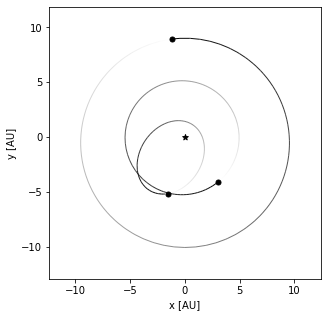

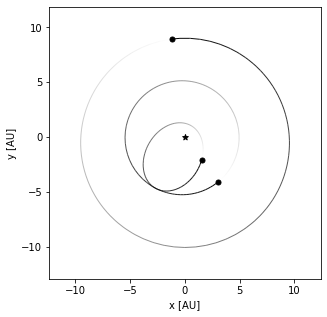

In [61]:
fig = rebound.OrbitPlot(ias15_smallstep, unitlabel="[AU]")
fig = rebound.OrbitPlot(ias15_bigstep, unitlabel="[AU]")
print("The small timestep energy at t=0 is: ",ias15_smallenergy_init)
print("The small timestep energy at t=70 yr is: ",ias15_smallenergy_final)
print("The large timestep energy at t=0 is: ",ias15_bigenergy_init)
print("The large timestep energy at t=70 yr is: ",ias15_bigenergy_final)

We see that using a larger timestep (1 year vs .001 year) causes the orbits to be very different. Rebound is even nice and warns us that our timestep is likely causing errors. When trying to compare the energy of the system, we don't see any difference between the two timestepping. I may have not utilized this function correctly.

In [62]:
#Trying WHFast
WH_smallstep = rebound.Simulation()
WH_smallstep.integrator = "whfast" 
WH_smallstep.add("Sun")
WH_smallstep.add("Jupiter")
WH_smallstep.add("Saturn")
WH_smallstep.add("Churyumov-Gerasimenko", m=5.03e-18)
time = 70 * year #time to integrate by
WH_smallstep.dt = 1e-3*year #timestep for IAS15 integrator
WH_smallstep.integrate(time)
WH_smallenergy = WH_smallstep.calculate_energy()
WH_bigstep = rebound.Simulation()
WH_bigstep.integrator = "whfast" 
WH_bigstep.add("Sun")
WH_bigstep.add("Jupiter")
WH_bigstep.add("Saturn")
WH_bigstep.add("Churyumov-Gerasimenko", m=5.03e-18)
time = 70 * year #time to integrate by
WH_bigstep.dt = 1*year #timestep for IAS15 integrator
WH_bigstep.integrate(time)
WH_bigenergy = WH_bigstep.calculate_energy()

Searching NASA Horizons for 'Sun'... 
Found: Sun (10) 
Searching NASA Horizons for 'Jupiter'... 
Found: Jupiter Barycenter (5) (chosen from query 'Jupiter')
Searching NASA Horizons for 'Saturn'... 
Found: Saturn Barycenter (6) (chosen from query 'Saturn')
Searching NASA Horizons for 'Churyumov-Gerasimenko'... 
Found: 67P/Churyumov-Gerasimenko (chosen from query 'Churyumov-Gerasimenko')
Searching NASA Horizons for 'Sun'... 
Found: Sun (10) 
Searching NASA Horizons for 'Jupiter'... 
Found: Jupiter Barycenter (5) (chosen from query 'Jupiter')
Searching NASA Horizons for 'Saturn'... 
Found: Saturn Barycenter (6) (chosen from query 'Saturn')
Searching NASA Horizons for 'Churyumov-Gerasimenko'... 
Found: 67P/Churyumov-Gerasimenko (chosen from query 'Churyumov-Gerasimenko')


The small timestep energy at t=0 is:  -0.00010675554310027012
The big timestep energy at t=70 yr is:  -0.00010675540016985186


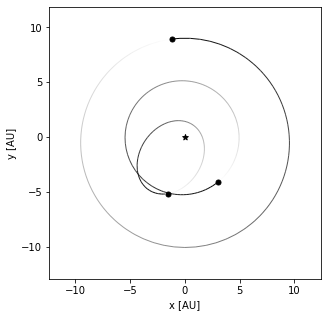

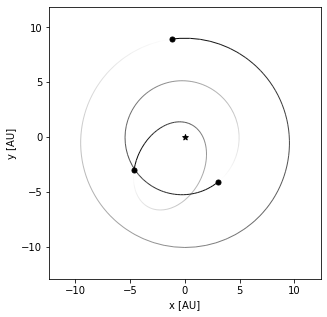

In [63]:
fig = rebound.OrbitPlot(WH_smallstep, unitlabel="[AU]")
fig = rebound.OrbitPlot(WH_bigstep, unitlabel="[AU]")
print("The small timestep energy at t=0 is: ",WH_smallenergy)
print("The big timestep energy at t=70 yr is: ",WH_bigenergy)

We note that the WH and IAS15 give comparable results for the small timestep, while the larger timesteps are both quite different. From the literature we expect the IAS15 to be more accurate.

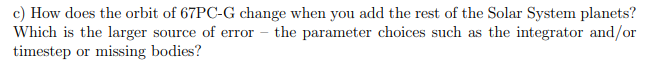

In [66]:
fullsolar = rebound.Simulation()
fullsolar.add("Sun")
fullsolar.add("Mercury")
fullsolar.add("Venus")
fullsolar.add("Earth")
fullsolar.add("Mars")
fullsolar.add("Jupiter")
fullsolar.add("Saturn")
fullsolar.add("Uranus")
fullsolar.add("Neptune")
fullsolar.add("Pluto") #Pleases don't take off points for Pluto being in here. I'm a 90s kid. 
fullsolar.add("Churyumov-Gerasimenko", m=5.03e-18)
#Realized after the fact that there is a command called rebound.data.add_solar_system()

Searching NASA Horizons for 'Sun'... 
Found: Sun (10) 
Searching NASA Horizons for 'Mercury'... 
Found: Mercury Barycenter (199) (chosen from query 'Mercury')
Searching NASA Horizons for 'Venus'... 
Found: Venus Barycenter (299) (chosen from query 'Venus')
Searching NASA Horizons for 'Earth'... 
Found: Earth-Moon Barycenter (3) (chosen from query 'Earth')
Searching NASA Horizons for 'Mars'... 
Found: Mars Barycenter (4) (chosen from query 'Mars')
Searching NASA Horizons for 'Jupiter'... 
Found: Jupiter Barycenter (5) (chosen from query 'Jupiter')
Searching NASA Horizons for 'Saturn'... 
Found: Saturn Barycenter (6) (chosen from query 'Saturn')
Searching NASA Horizons for 'Uranus'... 
Found: Uranus Barycenter (7) (chosen from query 'Uranus')
Searching NASA Horizons for 'Neptune'... 
Found: Neptune Barycenter (8) (chosen from query 'Neptune')
Searching NASA Horizons for 'Pluto'... 
Found: Pluto Barycenter (9) (chosen from query 'Pluto')
Searching NASA Horizons for 'Churyumov-Gerasimenko'

In [67]:
time = 70 * year #time to integrate by
fullsolar.ri_ias15.min_dt = 1e-3*year #timestep for IAS15 integrator
fullsolar.integrate(time)
fullsolar_energy = ias15_smallstep.calculate_energy()

The energy for the full solar system is:  -0.00010675554310039188


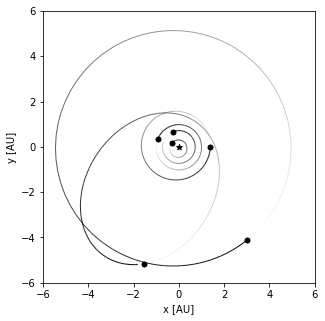

In [78]:
fig = rebound.OrbitPlot(fullsolar, unitlabel="[AU]",xlim=[-6,6],ylim=[-6,6])
print("The energy for the full solar system is: ",fullsolar_energy)

We see the position of the comet (bottom particle in this plot) isn't very different in the full solar system. This is because the main actors on its orbit are the Sun and Jupiter (arguably Saturn too). The addition of the terrestrial planets and farther out ice giants don't seem to impact things terribly. I would argue the timestep produce the largest source of error, when going too large.

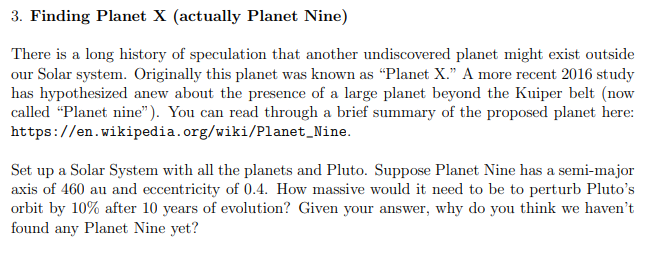

In [101]:
sys = rebound.Simulation()
sys.units = ('yr','AU','Msun')
sys.add("Sun")
sys.add("Mercury")
sys.add("Venus")
sys.add("Earth")
sys.add("Mars")
sys.add("Jupiter")
sys.add("Saturn")
sys.add("Uranus")
sys.add("Neptune")
sys.add("Pluto")
sys.move_to_hel() #move to Solar coordinate system
time = 10 * year #time to integrate by
sys.min_dt = 1e-3*year #timestep for IAS15 integrator
sys.integrate(time)
pluto_no_x = sys.particles[9].calculate_orbit(primary=sys.particles[0])
sys_x = rebound.Simulation()
sys_x.units = ('yr','AU','Msun')
sys_x.add("Sun")
sys_x.add("Mercury")
sys_x.add("Venus")
sys_x.add("Earth")
sys_x.add("Mars")
sys_x.add("Jupiter")
sys_x.add("Saturn")
sys_x.add("Uranus")
sys_x.add("Neptune")
sys_x.add("Pluto")
sys_x.add(m=8,a=460,e=0.4)
sys_x.move_to_hel() #move to Solar coordinate system
time = 10 * year #time to integrate by
sys_x.min_dt = 1e-3*year #timestep for IAS15 integrator
sys_x.integrate(time)
pluto_x = sys_x.particles[9].calculate_orbit(primary=sys_x.particles[0])

Searching NASA Horizons for 'Sun'... 
Found: Sun (10) 
Searching NASA Horizons for 'Mercury'... 
Found: Mercury Barycenter (199) (chosen from query 'Mercury')
Searching NASA Horizons for 'Venus'... 
Found: Venus Barycenter (299) (chosen from query 'Venus')
Searching NASA Horizons for 'Earth'... 
Found: Earth-Moon Barycenter (3) (chosen from query 'Earth')
Searching NASA Horizons for 'Mars'... 
Found: Mars Barycenter (4) (chosen from query 'Mars')
Searching NASA Horizons for 'Jupiter'... 
Found: Jupiter Barycenter (5) (chosen from query 'Jupiter')
Searching NASA Horizons for 'Saturn'... 
Found: Saturn Barycenter (6) (chosen from query 'Saturn')
Searching NASA Horizons for 'Uranus'... 
Found: Uranus Barycenter (7) (chosen from query 'Uranus')
Searching NASA Horizons for 'Neptune'... 
Found: Neptune Barycenter (8) (chosen from query 'Neptune')
Searching NASA Horizons for 'Pluto'... 
Found: Pluto Barycenter (9) (chosen from query 'Pluto')
Searching NASA Horizons for 'Sun'... 
Found: Sun (1

In [102]:
#We'll take the ratio of the semi-major axes of Pluto after 10 years, with and without Planet X.
#I could have written a while look to re-run this simulation and increase Planet X mass
#Until the 10% condition was met, but I couldn't figure out how to suppress the rebound planet additions
#So I just adjusted it manually and re-ran the above cell until it was met.
print("The fractional change in Pluto's orbit is:", 1-(pluto_no_x.a / pluto_x.a))

The fractional change in Pluto's orbit is: 0.10348987356531458


So for Planet X with this orbit would need to be about 8 solar masses to cause a 10% shift in Pluto's Orbit. At this mass, it would be fusing and be quite luminous. Planet X, if it exists, likely has not been detected because it's mass is probably small enough that it's very difficulty to detect any diffence in the orbit of Pluto due to its gravity.